In [ ]:
import kagglehub
vipoooool_new_plant_diseases_dataset_path = kagglehub.dataset_download('vipoooool/new-plant-diseases-dataset')
santiagosangrocid_plantdoc_model_keras_default_1_path = kagglehub.model_download('santiagosangrocid/plantdoc_model/Keras/default/1')

print('Data source import complete.')


Data source import complete.


In [ ]:
!pip install httpx==0.13.3
# Uninstall packages from Kaggle base image that are not needed.
!pip uninstall -qy jupyterlab jupyterlab-lsp
# Install gradio for chat user interface.
!pip install -qU gradio
# Install the google-genai SDK for this codelab.
!pip install -qU 'google-genai==1.7.0'

  Using cached httpx-0.13.3-py3-none-any.whl.metadata (25 kB)
  Using cached httpcore-0.9.1-py3-none-any.whl.metadata (4.6 kB)
  Using cached h11-0.9.0-py2.py3-none-any.whl.metadata (8.1 kB)
Using cached httpx-0.13.3-py3-none-any.whl (55 kB)
Using cached httpcore-0.9.1-py3-none-any.whl (42 kB)
Using cached h11-0.9.0-py2.py3-none-any.whl (53 kB)
  Attempting uninstall: h11
    Found existing installation: h11 0.14.0
    Uninstalling h11-0.14.0:
      Successfully uninstalled h11-0.14.0
  Attempting uninstall: httpcore
    Found existing installation: httpcore 1.0.8
    Uninstalling httpcore-1.0.8:
      Successfully uninstalled httpcore-1.0.8
  Attempting uninstall: httpx
    Found existing installation: httpx 0.28.1
    Uninstalling httpx-0.28.1:
      Successfully uninstalled httpx-0.28.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gradio-client 1.9.0 requ

In [ ]:
from google import genai
from google.genai import types

from IPython.display import Markdown, HTML, display

genai.__version__

'1.7.0'

In [ ]:
from getpass import getpass
import google.generativeai as genai

# Get your API key safely
GOOGLE_API_KEY = getpass("Enter your Google API Key: ")

# Configure the Gemini client
genai.configure(api_key=GOOGLE_API_KEY)

# client = genai.Client(api_key=GOOGLE_API_KEY)

# Use the current supported model
model = genai.GenerativeModel("gemini-1.5-pro")

Enter your Google API Key: ··········


In [ ]:
from google.api_core import retry

# Use the correct error class
from google.api_core.exceptions import ResourceExhausted, ServiceUnavailable

is_retriable = lambda e: isinstance(e, (ResourceExhausted, ServiceUnavailable))

# Fix: Reference correct method on GenerativeModel class
if not hasattr(genai.GenerativeModel.generate_content, '__wrapped__'):
    genai.GenerativeModel.generate_content = retry.Retry(
        predicate=is_retriable
    )(genai.GenerativeModel.generate_content)


In [ ]:
import warnings
warnings.filterwarnings('ignore')
import os
import numpy as np
import matplotlib.pyplot as plt
import gradio as gr
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image

In [ ]:
root_dir = '/kaggle/input/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/'

train_dir = root_dir + "/train"
valid_dir = root_dir + "/valid"
Diseases_classes = os.listdir(train_dir)

The Number of Images in Tomato___Late_blight: 1851 

The Number of Images in Tomato___healthy: 1926 

The Number of Images in Grape___healthy: 1692 

The Number of Images in Orange___Haunglongbing_(Citrus_greening): 2010 

The Number of Images in Soybean___healthy: 2022 

The Number of Images in Squash___Powdery_mildew: 1736 

The Number of Images in Potato___healthy: 1824 

The Number of Images in Corn_(maize)___Northern_Leaf_Blight: 1908 

The Number of Images in Tomato___Early_blight: 1920 

The Number of Images in Tomato___Septoria_leaf_spot: 1745 

The Number of Images in Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot: 1642 

The Number of Images in Strawberry___Leaf_scorch: 1774 

The Number of Images in Peach___healthy: 1728 

The Number of Images in Apple___Apple_scab: 2016 

The Number of Images in Tomato___Tomato_Yellow_Leaf_Curl_Virus: 1961 

The Number of Images in Tomato___Bacterial_spot: 1702 

The Number of Images in Apple___Black_rot: 1987 

The Number of Images in 

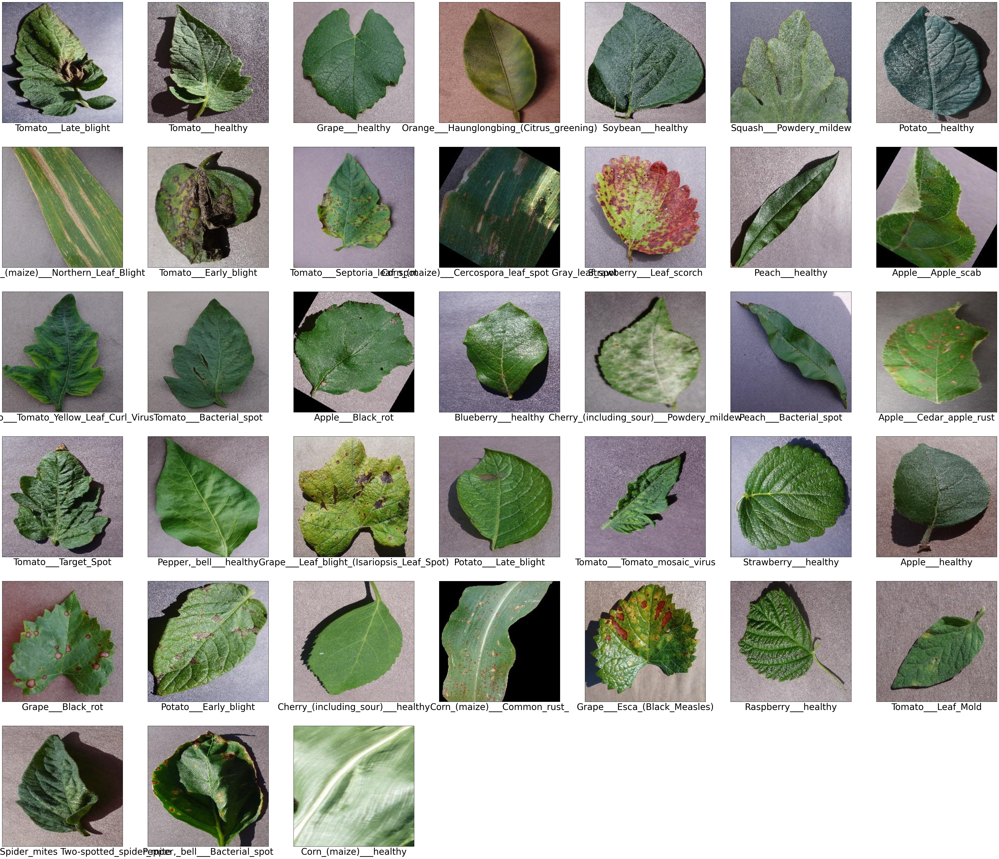

In [ ]:
plt.figure(figsize=(60,60))
cnt = 0
plant_names = []
tot_images = 0
for i in Diseases_classes:
    cnt += 1
    plant_names.append(i)
    plt.subplot(7,7,cnt)

    image_path = os.listdir(train_dir + "/" + i)
    print("The Number of Images in " +i+ ":", len(image_path), end= " ")
    print("\n")
    tot_images += len(image_path)

    img_show = plt.imread(train_dir + "/" + i + "/" + image_path[0])
    plt.imshow(img_show)
    plt.xlabel(i,fontsize=30)
    plt.xticks([])
    plt.yticks([])

In [ ]:
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 16
EPOCHS = 5

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1./224,
    rotation_range=20,
    zoom_range=0.2,
    shear_range=0.2,
    horizontal_flip=True
)

valid_datagen = ImageDataGenerator(rescale=1./224)

train_data = train_datagen.flow_from_directory(
    train_dir,
    target_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical'
)
valid_data = valid_datagen.flow_from_directory(
    valid_dir,
    target_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical'
)

num_classes = len(train_data.class_indices)

Found 70295 images belonging to 38 classes.
Found 17572 images belonging to 38 classes.


In [ ]:
''''
#This cell is run only to train Model
base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
base_model.trainable = False  # Freeze base model layers

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dropout(0.3)(x)
predictions = Dense(num_classes, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)'''


"'\n#This cell is run only to train Model\nbase_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))\nbase_model.trainable = False  # Freeze base model layers\n\nx = base_model.output\nx = GlobalAveragePooling2D()(x)\nx = Dropout(0.3)(x)\npredictions = Dense(num_classes, activation='softmax')(x)\n\nmodel = Model(inputs=base_model.input, outputs=predictions)"

In [ ]:
'''
#This cell will be used only to train model
# Compile and train
model.compile(optimizer=Adam(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

callbacks = [
    EarlyStopping(patience=3, restore_best_weights=True),
    ModelCheckpoint("/kaggle/working/best_model.keras", save_best_only=True)
]

history = model.fit(
    train_data,
    validation_data=valid_data,
    epochs=EPOCHS,
    callbacks=callbacks
)'''

'\n#This cell will be used only to train model\n# Compile and train\nmodel.compile(optimizer=Adam(learning_rate=0.0001),\n              loss=\'categorical_crossentropy\',\n              metrics=[\'accuracy\'])\n\ncallbacks = [\n    EarlyStopping(patience=3, restore_best_weights=True),\n    ModelCheckpoint("/kaggle/working/best_model.keras", save_best_only=True)\n]\n\nhistory = model.fit(\n    train_data,\n    validation_data=valid_data,\n    epochs=EPOCHS,\n    callbacks=callbacks\n)'

In [ ]:
'''model.save('my_model.keras')  # or use .keras
from google.colab import files
files.download('my_model.keras')
from google.colab import drive
drive.mount('/content/drive')
model.save('/content/drive/My Drive/my_model.keras')'''


"model.save('my_model.keras')  # or use .keras\nfrom google.colab import files\nfiles.download('my_model.keras')\nfrom google.colab import drive\ndrive.mount('/content/drive')\nmodel.save('/content/drive/My Drive/my_model.keras')"

In [ ]:
'''# Model is 93% accurate.
loss, acc = model.evaluate(valid_data)
print(f"Validation Accuracy: {acc * 100:.2f}%")'''

'# Model is 93% accurate.\nloss, acc = model.evaluate(valid_data)\nprint(f"Validation Accuracy: {acc * 100:.2f}%")'

In [ ]:
from google.colab import drive
from tensorflow.keras.models import load_model
import os

drive.mount('/content/drive')

model_path = '/content/drive/MyDrive/my_model.keras'

if os.path.exists(model_path):
    model = load_model(model_path)
    print("Model loaded successfully.")
else:
    print(f"Model not found at: {model_path}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Model loaded successfully.


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


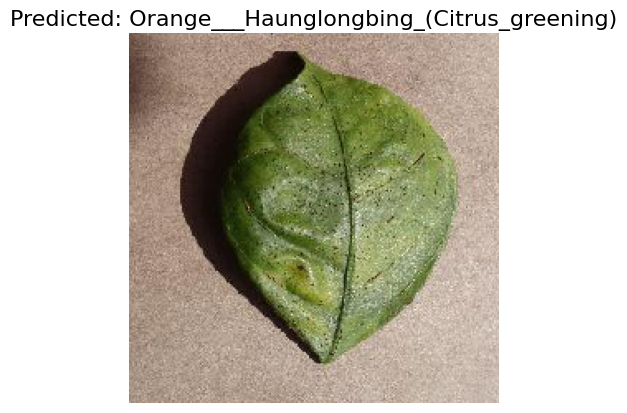

In [ ]:
#image Loading
img_path = os.path.join(train_dir, 'Orange___Haunglongbing_(Citrus_greening)',
                        os.listdir(os.path.join(train_dir, 'Orange___Haunglongbing_(Citrus_greening)'))[100])

img = image.load_img(img_path, target_size=IMAGE_SIZE)
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)  # Make batch of 1
img_array /= 224.0  # Normalize as done during training

# Make prediction
predictions = model.predict(img_array)
#For predictions, select highest class
predicted_class = np.argmax(predictions, axis=1)[0]
# Map class index to class label
class_labels = list(train_data.class_indices.keys())  # reuse from earlier
predicted_label = class_labels[predicted_class]

plt.imshow(img)
plt.title(f"Predicted: {predicted_label}", fontsize=16)
plt.axis('off')
plt.show()

In [ ]:
def extract_disease(label):
    try:
        parts = label.split("___")
        if len(parts) < 2:  # In case there's no '___' in the label
            raise ValueError("Invalid label format.")

        # Check if the last part indicates "healthy"
        if "healthy" in parts[-1].lower():
            return "Healthy"

        # Format the disease name (replace underscores with spaces)
        disease = parts[-1].replace("_", " ")
        leaf = parts[0]
        return disease

    except Exception as e:
        print(f"Error processing label '{label}': {e}")
        return None  # Or some default return value


In [ ]:
few_shot_prompt ="""
You are a plant care assistant. Based on the disease diagnosis and user question, give a friendly, accurate, and helpful response. Always begin by stating what the diagnosis is.

EXAMPLE:
Diagnosis: Healthy
User Question: How often should I water it?
Answer: Your plant is healthy, great job! 🌱 For most healthy plants, watering once a week is enough, but always check the soil moisture.

EXAMPLE:
Diagnosis: Powdery Mildew
User Question: What should I do now?
Answer: Powdery Mildew is a fungal infection. 🌿 Remove affected leaves and avoid watering from above. Neem oil or a mild fungicide can help treat it.

EXAMPLE:
Diagnosis: Leaf Spot
User Question: Is it dangerous to other plants?
Answer: Leaf Spot can spread if not treated. 🍂 Keep the infected plant isolated and remove affected leaves. Maintain good air circulation and avoid water splashes.

NEW CASE:
"""


In [ ]:
import numpy as np
import google.generativeai as genai
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
import gradio as gr


model = load_model(model_path)  # Update with the correct path

# Get class labels (used in training)
class_labels = list(train_data.class_indices.keys())  # Ensure train_data is defined

# Image preprocessing function
def preprocess_image(img):
    img = img.resize((224, 224))  # Change to your model’s input size (e.g., (224, 224))
    img = np.array(img) / 255.0  # Normalize the Image (assuming model was trained this way)
    img = np.expand_dims(img, axis=0)
    return img

# Diagnose plant function
def diagnose_plant(image):
    try:
        img = preprocess_image(image)
        prediction = model.predict(img)
        predicted_class = class_labels[np.argmax(prediction)]
        disease_name = extract_disease(predicted_class)
        return disease_name
    except Exception as e:
        print(f"Error: {e}")
        return None

# Generative AI model initialization
genai_model = genai.GenerativeModel('gemini-2.0-flash')  # Initialize the model once

# Generative AI model call function
def model_call(text, disease):
    user_case = f"""
    Diagnosis: {disease}
    User Question: {text}
    """
    try:
        response = genai_model.generate_content(
            contents=[few_shot_prompt, user_case]  # Ensure few_shot_prompt is defined
        )

        full_response = ""
        if response and hasattr(response, 'candidates'):
            for candidate in response.candidates:
                if hasattr(candidate, 'content') and hasattr(candidate.content, 'parts'):
                    for part in candidate.content.parts:
                        full_response += part.text + "\n"
        else:
            full_response = "[No valid response from model]"

        return full_response.strip()

    except Exception as e:
        error_msg = f"[ERROR in model_call] {str(e)}"
        print(error_msg)
        return error_msg


# Function to process inputs in the Gradio interface
def process_inputs(image, text):
    try:
        # If text is empty, set default text
        if not text.strip():
            text = "leaf species- , condition- healthy/unhealthy , solution-(if unhealthy)"

        disease = diagnose_plant(image)
        response = model_call(text, disease)
        return response
    except Exception as e:
        print(f"Error in processing inputs: {e}")
        return "Sorry, there was an error processing your request."


# Create Gradio chatbot interface
chatbot = gr.Interface(
    fn=process_inputs,
    inputs=[gr.Image(type="pil"), gr.Textbox()],
    outputs=gr.Markdown(),
    title="Plant Disease Diagnosis Bot",
    description="Upload a plant leaf image and get the disease diagnosis with treatment advice."
)

# Launch the app
chatbot.launch(share=True, debug=True)


Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
* Running on public URL: https://b4e4ab1babf2d820eb.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 756ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step
Error: 'NoneType' object has no attribute 'resize'
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step
[ERROR in model_call] HTTPConnectionPool(host='localhost', port=37481): Read timed out. (read timeout=600.0)
Keyboard interruption in main thread... closing server.
Killing tunnel 127.0.0.1:7860 <> https://b4e4ab1babf2d820eb.gradio.live
